<a href="https://colab.research.google.com/github/nuriacasana/introgeodf/blob/main/pc_grupal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center><img src="https://i.imgur.com/zRrFdsf.png" width="700"></center>



<a target="_blank" href="https://colab.research.google.com/github/CienciaDeDatosEspacial/GeoDataFrame_SpatialOperation/blob/main/GeoDF_Operations.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

# Basic spatial operations in  Geo Dataframes

We will review some important operations for geodataframes.

Let's remember the contents of the world map from last session:

<a class="anchor" id="0"></a>

In [97]:
!pip install fiona

In [98]:
linkWorldMap="https://github.com/CienciaDeDatosEspacial/intro_geodataframe/raw/main/maps/worldMaps.gpkg"


import geopandas as gpd
from  fiona import listlayers
print(listlayers(linkWorldMap))

['indicators', 'countries', 'rivers', 'cities']


Let's open all the layers (this takes a minute):

In [99]:
countries=gpd.read_file(linkWorldMap,layer='countries')
rivers=gpd.read_file(linkWorldMap,layer='rivers')
cities=gpd.read_file(linkWorldMap,layer='cities')
indicators=gpd.read_file(linkWorldMap,layer='indicators')



Now, let's see some important spatial operations:

1. [Subsetting](#1)
2. [Combining GeoDF rows](#3)
3. [The convex hull](#4)
4. [Spatial Overlays](#5)
5. [Checking Validity](#6)




<a class="anchor" id="1"></a>

# Subsetting

## Filtering

You can keep some elements by subsetting by *filtering*, as we used to do in common pandas data frames.

In [100]:
countries.head()

,COUNTRY,geometry
0,Aruba (Netherlands),"MULTIPOLYGON (((-69.88223 12.41111, -69.94695 ..."
1,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
2,Afghanistan,"MULTIPOLYGON (((61.27656 35.60725, 61.29638 35..."
3,Algeria,"MULTIPOLYGON (((-5.15213 30.18047, -5.13917 30..."
4,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38..."


In [101]:
# as DF
countries.iloc[50:,]

,COUNTRY,geometry
50,Central African Republic,"MULTIPOLYGON (((20.4533 4.52379, 20.45798 4.61..."
51,Cuba,"MULTIPOLYGON (((-76.94608 21.45221, -76.8839 2..."
52,Cape Verde,"MULTIPOLYGON (((-25.28139 16.91333, -25.29861 ..."
53,Cook Islands (New Zealand),"MULTIPOLYGON (((-165.84167 -10.89084, -165.848..."
54,Cyprus,"MULTIPOLYGON (((33.27229 34.70955, 33.21722 34..."
...,...,...
247,South Sudan,"MULTIPOLYGON (((34.21807 9.96458, 34.20722 9.9..."
248,Indonesia,"MULTIPOLYGON (((123.21846 -10.80917, 123.19832..."
249,East Timor,"MULTIPOLYGON (((124.41824 -9.3001, 124.40446 -..."
250,Curacao (Netherlands),"MULTIPOLYGON (((-68.96556 12.19889, -68.91196 ..."


In [102]:
# as DF
countries.loc[50:,'geometry']

,geometry
50,"MULTIPOLYGON (((20.4533 4.52379, 20.45798 4.61..."
51,"MULTIPOLYGON (((-76.94608 21.45221, -76.8839 2..."
52,"MULTIPOLYGON (((-25.28139 16.91333, -25.29861 ..."
53,"MULTIPOLYGON (((-165.84167 -10.89084, -165.848..."
54,"MULTIPOLYGON (((33.27229 34.70955, 33.21722 34..."
...,...
247,"MULTIPOLYGON (((34.21807 9.96458, 34.20722 9.9..."
248,"MULTIPOLYGON (((123.21846 -10.80917, 123.19832..."
249,"MULTIPOLYGON (((124.41824 -9.3001, 124.40446 -..."
250,"MULTIPOLYGON (((-68.96556 12.19889, -68.91196 ..."


But as a GeDF, you can also filter using a coordinate point via __cx__. Let me get the bounding box of the map:

In [7]:
countries.total_bounds

array([-180.        ,  -90.        ,  180.        ,   83.62359619])

As you are getting __[minx, miny, maxx, maxy]__ let me select a valid coordinate, i.e. (0,0)

In [103]:
countries.cx[:0,:0]

,COUNTRY,geometry
9,American Samoa (US),"MULTIPOLYGON (((-170.7439 -14.37556, -170.7494..."
10,Argentina,"MULTIPOLYGON (((-71.01648 -36.47591, -70.98195..."
14,Antarctica,"MULTIPOLYGON (((-45.14528 -60.76611, -45.15639..."
24,Bolivia,"MULTIPOLYGON (((-62.19884 -20.47139, -62.26945..."
29,Brazil,"MULTIPOLYGON (((-70.62862 -9.94849, -70.62889 ..."
42,Chile,"MULTIPOLYGON (((-73.61806 -51.6339, -73.60494 ..."
47,Colombia,"MULTIPOLYGON (((-81.71306 12.49028, -81.72014 ..."
53,Cook Islands (New Zealand),"MULTIPOLYGON (((-165.84167 -10.89084, -165.848..."
58,Jarvis Island (US),"MULTIPOLYGON (((-160.02115 -0.39806, -160.0281..."
60,Ecuador,"MULTIPOLYGON (((-78.70903 -4.58479, -78.72348 ..."


<Axes: >

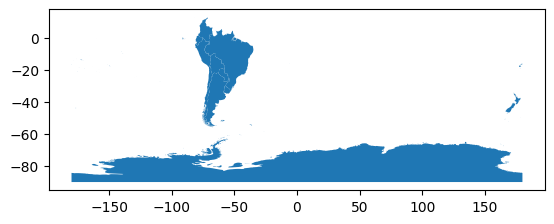

In [104]:
#then
countries.cx[:0,:0].plot()

Notice __cx__ would be cleaner if spatial element is a point.

## Clipping

Let me keep one country:

In [105]:
#PARA ITEM 1 DE (EJERCICIO 1)
Germany=countries[countries.COUNTRY=='Germany']

As we saw last week, we  can also subset by *clipping*, as sometimes other data frames may not have the same fields for filtering:

In [106]:
#Recorto con gdp y obtenemos nuevo GDF
citiesGermany_clipped = gpd.clip(gdf=cities,
                          mask=Germany)
riversGermany_clipped = gpd.clip(gdf=rivers,
                               mask=Germany)

Then, you can plot the clipped version:

<Axes: >

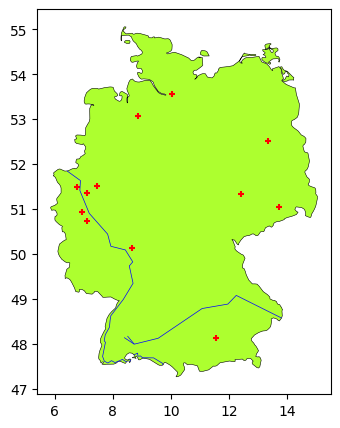

In [107]:
base = Germany.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4,figsize=(5,5))
citiesGermany_clipped.plot(marker='+', color='red', markersize=15,
                    ax=base)
riversGermany_clipped.plot(edgecolor='blue', linewidth=0.5,
                    ax=base)

The geometry types are not modified:

In [108]:
set(Germany.geom_type), set(citiesGermany_clipped.geom_type), set(riversGermany_clipped.geom_type)

({'MultiPolygon'}, {'Point'}, {'MultiLineString'})

In [109]:

#Hallamos centroide de Alemania
Germany.centroid

<ipython-input-109-1123385764>:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  Germany.centroid


,0
87,POINT (10.39365 51.10656)


In [15]:
Germany.to_crs(25832).crs.axis_info

[Axis(name=Easting, abbrev=E, direction=east, unit_auth_code=EPSG, unit_code=9001, unit_name=metre),
 Axis(name=Northing, abbrev=N, direction=north, unit_auth_code=EPSG, unit_code=9001, unit_name=metre)]

In [110]:
Germany.to_crs(25832).centroid

,0
87,POINT (596343.988 5656461.701)


<Axes: >

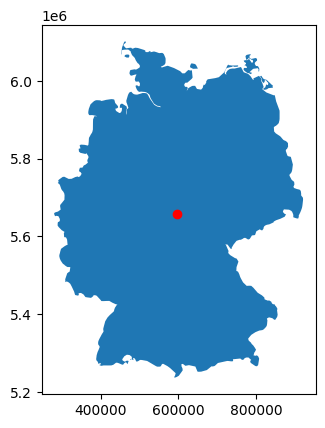

In [111]:
#Ploteamos mapa con centroide
base25832=Germany.to_crs(25832).plot()
Germany.to_crs(25832).centroid.plot(color='red',ax=base25832)

In [112]:
############### EJERCICIO 1
# Primero establecemos el centroide de Alemania
centroid_germany = Germany.to_crs(25832).centroid

# Obtenemos las coordenadas x e y del centroide
centroid_x = centroid_germany.x.iloc[0]
centroid_y = centroid_germany.y.iloc[0]


<Axes: >

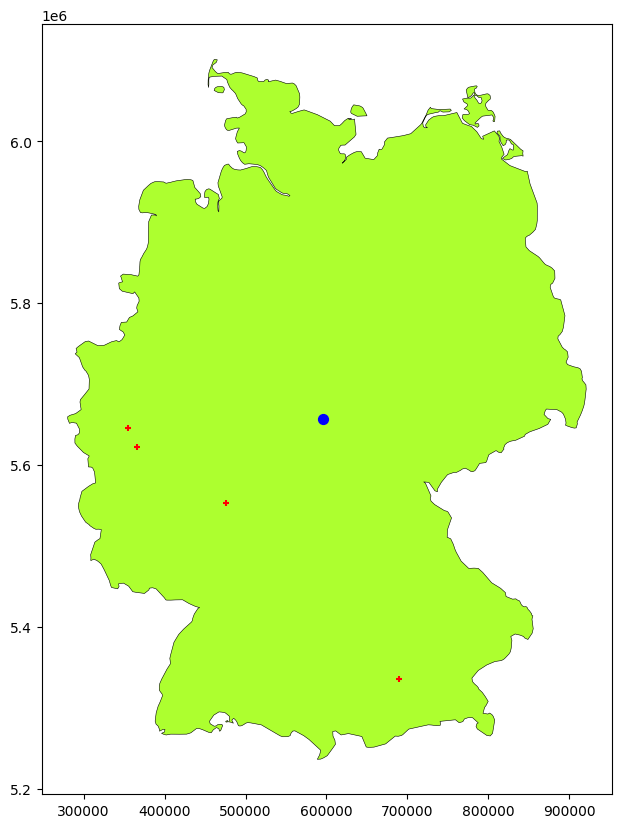

In [113]:
#### ITEM 1: EJERCICIO 1
#Para mostrar ciudades de zonas bajo centroide de Alemania

# Usamos cx para seleccionar ciudades en la zona bajo el centroide (menor o igual que la coordenada y del centroide)
cities_under_centroid = citiesGermany_clipped.to_crs(25832).cx[:, :centroid_y]

# Ploteamos las ciudades que están en la zona bajo el centroide
base_cities_under = Germany.to_crs(25832).plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(10, 10))
cities_under_centroid.plot(marker='+', color='red', markersize=15, ax=base_cities_under)
Germany.to_crs(25832).centroid.plot(color='blue', ax=base_cities_under, markersize=50)


<Axes: >

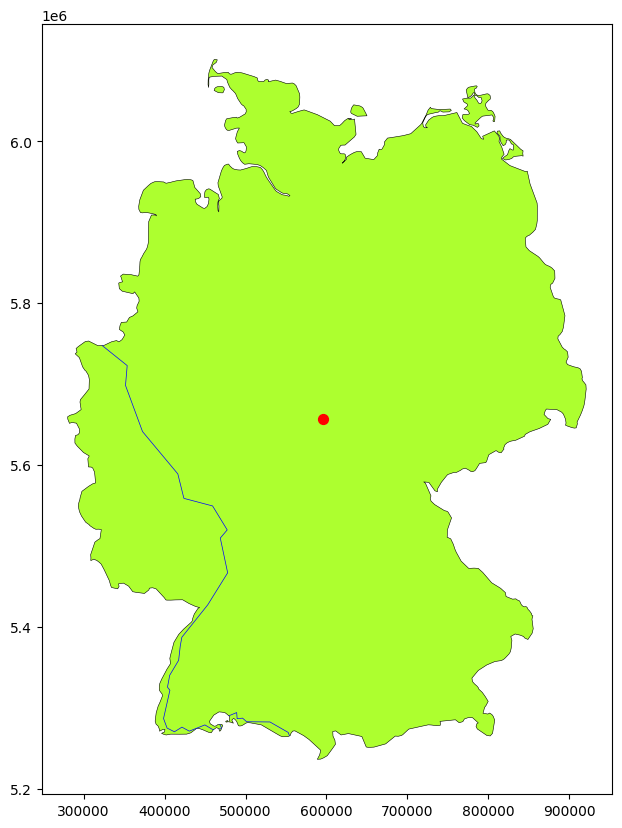

In [114]:
#### ITEM 2: EJERCICIO 1
#Para plotear rios de zonas arriba del centroide de Alemania

# Usamos cx para seleccionar rios en la zona arriba del centroide (mayor o igual que la coordenada y del centroide)
rivers_above_centroid = riversGermany_clipped.to_crs(25832).cx[:, centroid_y:]

# Ploteamos los rios que están en la zona arriba del centroide
base_rivers_above = Germany.to_crs(25832).plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(10, 10))
rivers_above_centroid.plot(edgecolor='blue', linewidth=0.5, ax=base_rivers_above)
Germany.to_crs(25832).centroid.plot(color='red', ax=base_rivers_above, markersize=50)

### Exercise 1
<div class="alert-success">

You will make two maps:
1. Plot your country as the background. Use **cx** to plot some **points** (the cities, airports, etc.) below the centroid.
2. Plot your country as the background. Select with **cx** all the first administrative divisions above the centroid. Then, use clip to show some **lines** (rivers, railroads, etc) that cross those divisions.
    
</div>

[TOC](#0)

_____________


<a class="anchor" id="3"></a>

# Combining GeoDF rows

Let me bring the projected data from Brazil.

In [117]:
LinkGermany="https://github.com/RosaMuguerza/Tarea-OperacionesGDFs/raw/refs/heads/main/data/gadm41_DEU_2.shp"
## we have
listlayers(LinkGermany)

['gadm41_DEU_2']

Let me open municipalities:

<Axes: >

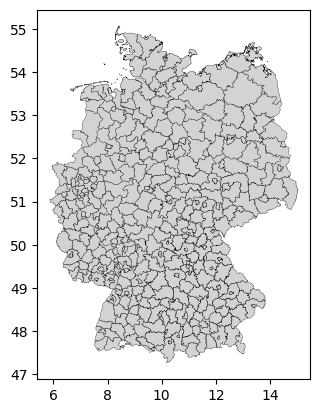

In [118]:
Germany_municipalities=gpd.read_file(LinkGermany,layer='gadm41_DEU_2')
Germany_municipalities.plot(facecolor='lightgrey', edgecolor='black',linewidth=0.2)

In [119]:
#see
Germany_municipalities.head()

,GID_2,GID_0,COUNTRY,GID_1,NAME_1,NL_NAME_1,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
0,DEU.1.1_1,DEU,Germany,DEU.1_1,Baden-Württemberg,NA,Alb-Donau-Kreis,NA,NA,Landkreis,District,08425,DE.BW.AD,"POLYGON ((9.67322 48.17136, 9.6741 48.16991, 9..."
1,DEU.1.2_1,DEU,Germany,DEU.1_1,Baden-Württemberg,NA,Baden-Baden,NA,NA,Stadtkreis,District,08211,DE.BW.BB,"MULTIPOLYGON (((8.11805 48.73807, 8.11372 48.7..."
2,DEU.1.3_1,DEU,Germany,DEU.1_1,Baden-Württemberg,NA,Biberach,NA,NA,Landkreis,District,08426,DE.BW.BR,"POLYGON ((9.75139 47.97439, 9.75106 47.97507, ..."
3,DEU.1.4_1,DEU,Germany,DEU.1_1,Baden-Württemberg,NA,Böblingen,NA,NA,Landkreis,District,08115,DE.BW.BL,"POLYGON ((8.8512 48.53292, 8.85111 48.53247, 8..."
4,DEU.1.5_1,DEU,Germany,DEU.1_1,Baden-Württemberg,NA,Bodensee,NA,NA,Water body,Water body,NA,NA,"POLYGON ((9.04492 47.81646, 9.04539 47.81644, ..."


In [185]:
## we have
len(Germany_municipalities.NAME_2)

403

In [186]:
# higher level count
len(set(Germany_municipalities.NAME_1))

16

Then, this is Minas Gerais:

<Axes: >

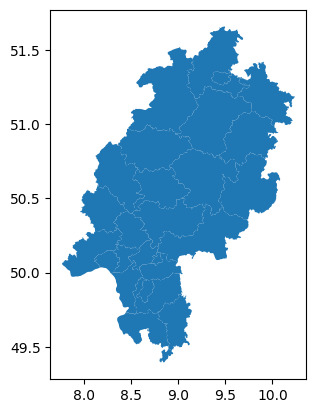

In [130]:
Germany_municipalities[Germany_municipalities.NAME_1=='Hessen'].plot()

Let's see the options to combine:

## Unary UNION

We can combine all these polygons into one:

In [123]:
!pip show shapely

Name: shapely
Version: 2.1.1
Summary: Manipulation and analysis of geometric objects
Home-page: 
Author: Sean Gillies
Author-email: 
License: BSD 3-Clause
Location: /usr/local/lib/python3.11/dist-packages
Requires: numpy
Required-by: bigframes, geopandas, google-cloud-aiplatform, libpysal


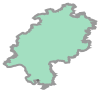

In [131]:
Germany_municipalities[Germany_municipalities.NAME_1=='Hessen'].union_all()

Let's save that result:

In [132]:
Hessen_union=Germany_municipalities[Germany_municipalities.NAME_1=='Hessen'].union_all()

In [133]:
# what do we have?
type(Hessen_union)

shapely.geometry.multipolygon.MultiPolygon

You can turn that shapely object into a GeoDF like this:

In [134]:
gpd.GeoDataFrame(index=[0],data={'NAME':'Hessen'},
                 crs=Germany_municipalities.crs,
                 geometry=[Hessen_union])

,NAME,geometry
0,Hessen,"MULTIPOLYGON (((8.68587 49.62167, 8.68588 49.6..."


<a class="anchor" id="21"></a>

## Dissolve

### a. Dissolve as Union
Using  **dissolve** is an alternative to _UNION_:

<Axes: >

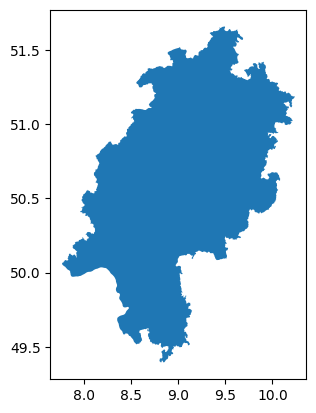

In [135]:
Germany_municipalities[Germany_municipalities.NAME_1=='Hessen'].dissolve().plot()

Let me save the result, and see the type :

In [136]:
Hessen_dissolve=Germany_municipalities[Germany_municipalities.NAME_1=='Hessen'].dissolve()

# we got?
type(Hessen_dissolve)

geopandas.geodataframe.GeoDataFrame

You got a GEOdf this time:

In [137]:
## see
Hessen_dissolve

,geometry,GID_2,GID_0,COUNTRY,GID_1,NAME_1,NL_NAME_1,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2
0,"MULTIPOLYGON (((8.68587 49.62167, 8.68588 49.6...",DEU.7.1_1,DEU,Germany,DEU.7_1,Hessen,NA,Bergstraße,NA,NA,Landkreis,District,06431,DE.HE.BR


In [141]:
# keeping what is relevant
# First, let's see the columns in the DataFrame
print(Hessen_dissolve.columns)

# Based on the columns, drop the ones that are not relevant
columns_to_drop = ['NAME_2','NL_NAME_1','VARNAME_2', 'NL_NAME_2','TYPE_2', 'ENGTYPE_2','CC_2','HASC_2']
# Filter out columns that are not in the DataFrame
existing_columns_to_drop = [col for col in columns_to_drop if col in Hessen_dissolve.columns]

Hessen_dissolve.drop(columns=existing_columns_to_drop, inplace=True)
Hessen_dissolve

Index(['geometry', 'GID_2', 'GID_0', 'COUNTRY', 'GID_1', 'NAME_1'], dtype='object')


,geometry,GID_2,GID_0,COUNTRY,GID_1,NAME_1
0,"MULTIPOLYGON (((8.68587 49.62167, 8.68588 49.6...",DEU.7.1_1,DEU,Germany,DEU.7_1,Hessen


### b. Dissolve for groups

Using _dissolve()_ with no arguments returns the union of the polygons, BUT also you get a GEOdf.
However, if you have a column that represents a grouping (as we do), you can dissolve by that column:

<Axes: >

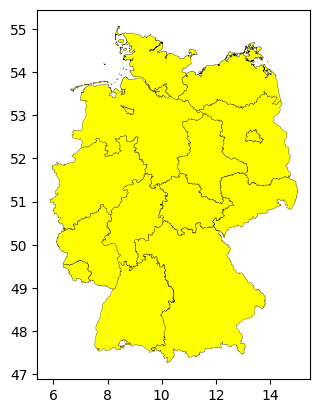

In [36]:
# dissolving
Germany_municipalities.dissolve(by='NAME_1').plot(facecolor='yellow', edgecolor='black',linewidth=0.2)

Again, let me save this result:

In [142]:
Germany_adm1_diss=Germany_municipalities.dissolve(by='NAME_1')

We know we have a GeoDF; let's see contents:

In [143]:
Germany_adm1_diss

,geometry,GID_2,GID_0,COUNTRY,GID_1,NL_NAME_1,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2
NAME_1,,,,,,,,,,,,,
Baden-Württemberg,"MULTIPOLYGON (((7.98326 47.55531, 7.98274 47.5...",DEU.1.1_1,DEU,Germany,DEU.1_1,NA,Alb-Donau-Kreis,NA,NA,Landkreis,District,08425,DE.BW.AD
Bayern,"POLYGON ((10.45294 47.55252, 10.45232 47.55122...",DEU.2.1_1,DEU,Germany,DEU.2_1,NA,Aichach-Friedberg,NA,NA,Landkreis,District,09771,DE.BY.AF
Berlin,"POLYGON ((13.50022 52.61379, 13.49855 52.61068...",DEU.3.1_1,DEU,Germany,DEU.3_1,NA,Berlin,NA,NA,Kreisfreie Stadt,District,11000,DE.BE.BR
Brandenburg,"MULTIPOLYGON (((13.15141 51.86432, 13.15093 51...",DEU.4.1_1,DEU,Germany,DEU.4_1,NA,Barnim,NA,NA,Landkreis,District,12060,DE.BB.BR
Bremen,"MULTIPOLYGON (((8.67532 53.17635, 8.6754 53.17...",DEU.5.1_1,DEU,Germany,DEU.5_1,NA,Bremen,NA,NA,Kreisfreie Stadt,District,04011,DE.HB.BR
Hamburg,"MULTIPOLYGON (((10.17511 53.71143, 10.17403 53...",DEU.6.1_1,DEU,Germany,DEU.6_1,NA,Hamburg,NA,NA,Kreisfreie Stadt,District,02000,DE.HH.HM
Hessen,"MULTIPOLYGON (((8.68587 49.62167, 8.68588 49.6...",DEU.7.1_1,DEU,Germany,DEU.7_1,NA,Bergstraße,NA,NA,Landkreis,District,06431,DE.HE.BR
Mecklenburg-Vorpommern,"MULTIPOLYGON (((11.56936 53.1661, 11.56904 53....",DEU.8.1_1,DEU,Germany,DEU.8_1,NA,Ludwigslust-Parchim,NA,NA,Landkreis,District,13076,DE.MV.LP
Niedersachsen,"MULTIPOLYGON (((7.93625 52.28543, 7.935 52.286...",DEU.9.1_1,DEU,Germany,DEU.9_1,NA,Ammerland,NA,NA,Landkreis,District,03451,DE.NI.AM


Again, we can drop columns that do not bring important information:

In [144]:
Germany_adm1_diss.drop(columns=['NAME_2','NL_NAME_1','VARNAME_2', 'NL_NAME_2','TYPE_2', 'ENGTYPE_2','CC_2','HASC_2'],inplace=True)
Germany_adm1_diss.reset_index(inplace=True)
Germany_adm1_diss.info()
Germany_adm1_diss.head()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 16 entries, 0 to 15
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   NAME_1    16 non-null     object  
 1   geometry  16 non-null     geometry
 2   GID_2     16 non-null     object  
 3   GID_0     16 non-null     object  
 4   COUNTRY   16 non-null     object  
 5   GID_1     16 non-null     object  
dtypes: geometry(1), object(5)
memory usage: 900.0+ bytes


,NAME_1,geometry,GID_2,GID_0,COUNTRY,GID_1
0,Baden-Württemberg,"MULTIPOLYGON (((7.98326 47.55531, 7.98274 47.5...",DEU.1.1_1,DEU,Germany,DEU.1_1
1,Bayern,"POLYGON ((10.45294 47.55252, 10.45232 47.55122...",DEU.2.1_1,DEU,Germany,DEU.2_1
2,Berlin,"POLYGON ((13.50022 52.61379, 13.49855 52.61068...",DEU.3.1_1,DEU,Germany,DEU.3_1
3,Brandenburg,"MULTIPOLYGON (((13.15141 51.86432, 13.15093 51...",DEU.4.1_1,DEU,Germany,DEU.4_1
4,Bremen,"MULTIPOLYGON (((8.67532 53.17635, 8.6754 53.17...",DEU.5.1_1,DEU,Germany,DEU.5_1


### c. Dissolve and aggregate

In pandas, you have can aggregate data using some statistics. Dissolve can be used in the same way. Let me use the _indicators_ layer:

In [40]:
indicators.head()

,COUNTRY,Officialstatename,InternetccTLD,iso2,iso3,fragility_date,fragility,co2,co2_date,region,ForestRev_gdp,ForestRev_date,fragility_Qt,fragility_Qt_jc5,fragility_Qt_jc5_cat,geometry
0,ANTIGUA AND BARBUDA,Antigua and Barbuda,.ag,AG,ATG,2019,54.4,729000.0,2019,CENTRAL AMERICA AND THE CARIBBEAN,0.00,2018,-0.530113,1,1_Good,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
1,AFGHANISTAN,The Islamic Republic of Afghanistan,.af,AF,AFG,2019,105.0,7893000.0,2019,SOUTH ASIA,0.20,2018,1.827146,4,4_Poor,"POLYGON ((61.27656 35.60725, 61.29638 35.62853..."
2,ALGERIA,The People's Democratic Republic of Algeria,.dz,DZ,DZA,2019,75.4,151633000.0,2019,AFRICA,0.10,2018,0.304520,3,3_Bad,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236..."
3,AZERBAIJAN,The Republic of Azerbaijan,.az,AZ,AZE,2019,73.2,35389000.0,2019,MIDDLE EAST,0.02,2018,0.233695,2,2_Middle,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38..."
4,ALBANIA,The Republic of Albania,.al,AL,ALB,2019,58.9,3794000.0,2019,EUROPE,0.18,2018,-0.424447,1,1_Good,"POLYGON ((20.79192 40.43154, 20.78722 40.39472..."


We have numerical columns, and a grouping column named _region_. Let's get some averages by region, while combining the polygons:

In [145]:
indicators.dissolve(
     by="region",
     aggfunc={
         "COUNTRY": "count",
         "fragility": ["mean"],
         "co2": ["mean"],
         "ForestRev_gdp": ["mean"]
     },as_index=False,
 )

,region,geometry,"(COUNTRY, count)","(fragility, mean)","(co2, mean)","(ForestRev_gdp, mean)"
0,AFRICA,"MULTIPOLYGON (((-2.92813 5.10022, -2.93222 5.1...",51,85.664706,1.670835e+07,3.239804
1,AUSTRALIA AND OCEANIA,"MULTIPOLYGON (((-176.51779 -43.90778, -176.532...",6,55.100000,7.679500e+07,3.630000
2,CENTRAL AMERICA AND THE CARIBBEAN,"MULTIPOLYGON (((-81.71556 7.44681, -81.71362 7...",16,62.993750,1.104856e+07,0.359375
3,CENTRAL ASIA,"MULTIPOLYGON (((50.03472 45.04833, 50.0425 45....",6,72.883333,3.898807e+08,0.236667
4,EAST AND SOUTHEAST ASIA,"MULTIPOLYGON (((105.26361 -6.54472, 105.26138 ...",15,64.120000,9.608337e+08,0.586667
5,EUROPE,"MULTIPOLYGON (((-18.13223 27.77264, -18.1132 2...",39,40.348718,9.866674e+07,0.199231
6,MIDDLE EAST,"MULTIPOLYGON (((42.76819 14.06653, 42.7868 14....",16,71.756250,1.583754e+08,0.032500
7,NORTH AMERICA,"MULTIPOLYGON (((-155.211 20.00166, -155.18335 ...",3,42.566667,2.073395e+09,0.073333
8,SOUTH AMERICA,"MULTIPOLYGON (((-74.93431 -51.85501, -74.93251...",11,61.436364,8.613718e+07,1.064545
9,SOUTH ASIA,"MULTIPOLYGON (((73.10193 -0.58431, 73.09915 -0...",8,83.975000,3.309434e+08,0.365000


Let me save and plot:

<Axes: >

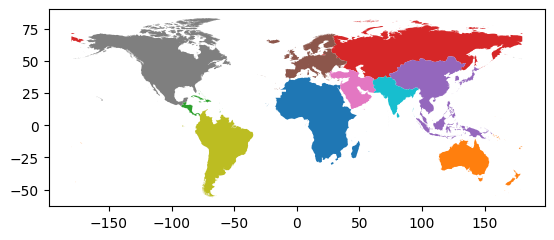

In [42]:
indicatorsByRegion=indicators.dissolve(
     by="region",
     aggfunc={
         "COUNTRY": "count",
         "fragility": ["mean"],
         "co2": ["mean"],
         "ForestRev_gdp": ["mean"]
     },as_index=False,
 )


indicatorsByRegion.plot(column = 'region')

Without renaming, you can request a choropleth:

In [146]:
!pip install mapclassify

<Axes: >

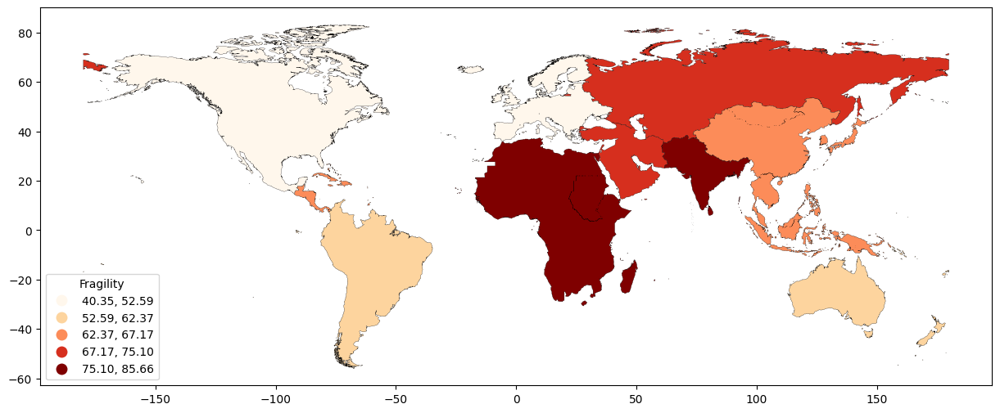

In [44]:
indicatorsByRegion.plot(column =('fragility', 'mean'),scheme='quantiles', cmap='OrRd',
                        legend=True,
                        legend_kwds={"title": "Fragility",'loc': 'lower left'},
                        edgecolor='black',linewidth=0.2,
                        figsize=(15, 10))

In [45]:
###### ITEM 3:
indicators.dissolve(
     by="region",
     aggfunc={
         "COUNTRY": "count",
         "fragility": ["median"],
         "co2": ["median"],
         "ForestRev_gdp": ["median"]
     },as_index=False,
 )

,region,geometry,"(COUNTRY, count)","(fragility, median)","(co2, median)","(ForestRev_gdp, median)"
0,AFRICA,"MULTIPOLYGON (((-2.92813 5.10022, -2.93222 5.1...",51,87.40,4444000.0,2.470
1,AUSTRALIA AND OCEANIA,"MULTIPOLYGON (((-176.51779 -43.90778, -176.532...",6,67.95,1023000.0,0.385
2,CENTRAL AMERICA AND THE CARIBBEAN,"MULTIPOLYGON (((-81.71556 7.44681, -81.71362 7...",16,61.00,7873500.0,0.115
3,CENTRAL ASIA,"MULTIPOLYGON (((50.03472 45.04833, 50.0425 45....",6,75.20,106001000.0,0.005
4,EAST AND SOUTHEAST ASIA,"MULTIPOLYGON (((105.26361 -6.54472, 105.26138 ...",15,70.40,238983000.0,0.180
5,EUROPE,"MULTIPOLYGON (((-18.13223 27.77264, -18.1132 2...",39,40.50,38739000.0,0.150
6,MIDDLE EAST,"MULTIPOLYGON (((42.76819 14.06653, 42.7868 14....",16,72.60,68706500.0,0.000
7,NORTH AMERICA,"MULTIPOLYGON (((-155.211 20.00166, -155.18335 ...",3,38.00,612084000.0,0.080
8,SOUTH AMERICA,"MULTIPOLYGON (((-74.93431 -51.85501, -74.93251...",11,68.20,36051000.0,0.490
9,SOUTH ASIA,"MULTIPOLYGON (((73.10193 -0.58431, 73.09915 -0...",8,84.35,15916000.0,0.120


<Axes: >

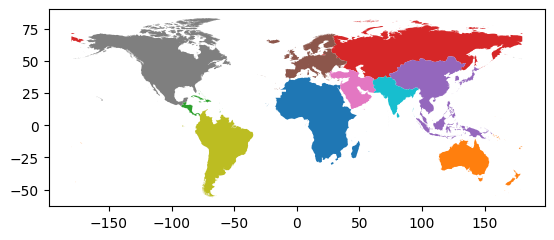

In [46]:
indicatorsByRegion=indicators.dissolve(
     by="region",
     aggfunc={
         "COUNTRY": "count",
         "fragility": ["median"],
         "co2": ["median"],
         "ForestRev_gdp": ["median"]
     },as_index=False,
 )


indicatorsByRegion.plot(column = 'region')

<Axes: >

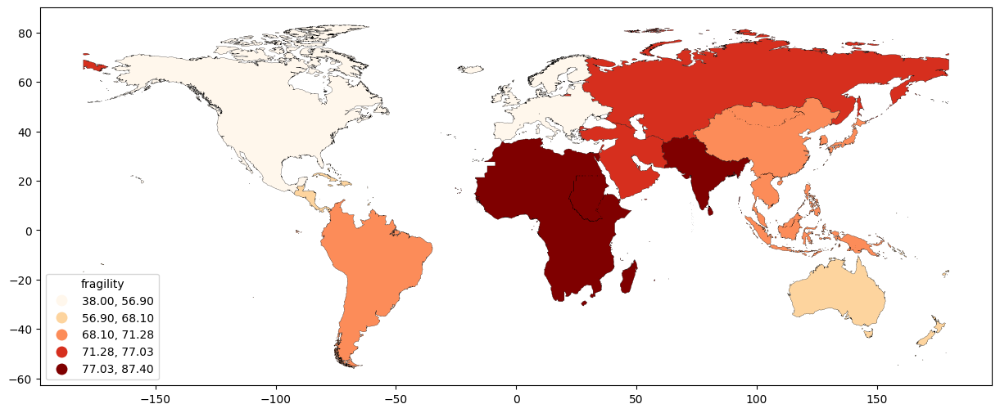

In [47]:
indicatorsByRegion.plot(column =('fragility', 'median'),scheme='quantiles', cmap='OrRd',
                        legend=True,
                        legend_kwds={"title": "fragility",'loc': 'lower left'},
                        edgecolor='black',linewidth=0.2,
                        figsize=(15, 10))

<Axes: >

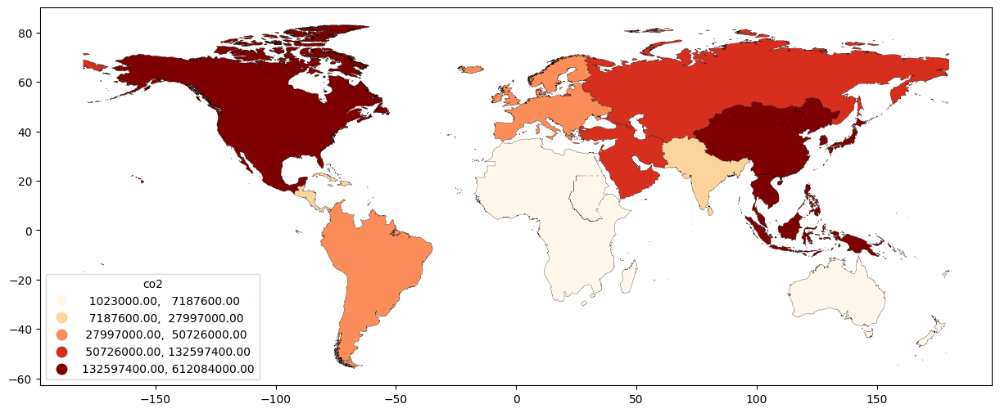

In [48]:
indicatorsByRegion.plot(column =('co2', 'median'),scheme='quantiles', cmap='OrRd',
                        legend=True,
                        legend_kwds={"title": "co2",'loc': 'lower left'},
                        edgecolor='black',linewidth=0.2,
                        figsize=(15, 10))

<Axes: >

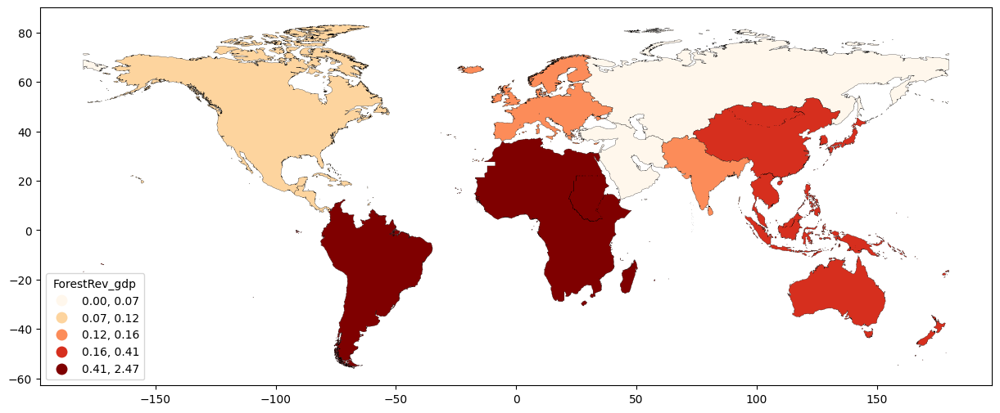

In [49]:
indicatorsByRegion.plot(column =('ForestRev_gdp', 'median'),scheme='quantiles', cmap='OrRd',
                        legend=True,
                        legend_kwds={"title": "ForestRev_gdp",'loc': 'lower left'},
                        edgecolor='black',linewidth=0.2,
                        figsize=(15, 10))

# Exercise 2

1. Create some subset of polygons with your country data at the municipal (or similar level). Use Unary UNION with those polygons, and create a geoDF with the result.
2. Dissolve your municipalities by another higher level administrative level. Plot the result.
3. If possible, color some areas of your country by aggregating; if not, plot the "median" values in the indicators map.

[TOC](#0)
_____________


<a class="anchor" id="4"></a>

# The convex hull

Some time you may have the need to create a polygon that serves as an envelope to a set of points.

For this example, let me compute the centroid coordinates:

In [153]:
linkWorldMap="https://github.com/CienciaDeDatosEspacial/intro_geodataframe/raw/main/maps/worldMaps.gpkg"

In [210]:
Germany_municipalities = gpd.read_file("https://github.com/TartariaData/GeoDF_Operations/raw/main/maps/gadm41_DEU_shp/gadm41_DEU_2.shp")

In [155]:
Germany=countries[countries.COUNTRY=='Germany']

In [211]:
Germany.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [157]:
Germany.centroid

,0
87,POINT (10.39365 51.10656)


In [232]:
Germany_25832=Germany.to_crs(25832)
cities_Germany_25832=citiesGermany_clipped.to_crs(Germany_25832.crs)
rivers_Germany_25832=riversGermany_clipped.to_crs(Germany_25832.crs)

In [233]:
# Guardamos un unico geopacke

import os

# Comprueba si el directorio "maps" existe
if not os.path.exists("maps"):
    os.makedirs("maps")  # Crea el directorio si no existe

Germany_25832.to_file(os.path.join("maps","GermanyMaps_25832.gpkg"), layer='country', driver="GPKG")
cities_Germany_25832.to_file(os.path.join("maps","GermanyMaps_25832.gpkg"), layer='cities', driver="GPKG")
rivers_Germany_25832.to_file(os.path.join("maps","GermanyMaps_25832.gpkg"), layer='rivers', driver="GPKG")
Germany_25832.centroid.to_file(os.path.join("maps","GermanyMaps_25832.gpkg"), layer='centroid', driver="GPKG")

In [165]:
MapGermanyAirports="https://github.com/RosaMuguerza/Tarea-OperacionesGDFs/raw/refs/heads/main/gadm41_DEU_shp/germanyMaps_25832_airport.gpkg"

In [215]:
Germany_municipalities.geometry.head()

,geometry
0,"POLYGON ((9.67322 48.17136, 9.6741 48.16991, 9..."
1,"MULTIPOLYGON (((8.11805 48.73807, 8.11372 48.7..."
2,"POLYGON ((9.75139 47.97439, 9.75106 47.97507, ..."
3,"POLYGON ((8.8512 48.53292, 8.85111 48.53247, 8..."
4,"POLYGON ((9.04492 47.81646, 9.04539 47.81644, ..."


In [216]:
centroGermany=Germany_25832.centroid
centroGermany

,0
87,POINT (596343.988 5656461.701)


In [235]:
# Las coordendas coordenadas
Germany_25832.centroid.x.values[0],Germany_25832.centroid.y.values[0]

(np.float64(596343.9884124283), np.float64(5656461.700987707))

In [218]:
airports_25832.head()

,name,kind,latitude_deg,longitude_deg,elevation_ft,region_name,municipality,geometry
0,Munich Airport,large_airport,48.353802,11.78610,1487.0,Bavaria,Munich,POINT (706396.099 5359376.354)
1,Berlin-Tegel Otto Lilienthal Airport,closed,52.559700,13.28770,122.0,Berlin,Berlin,POINT (790597.072 5831932.941)
2,Düsseldorf Airport,large_airport,51.289501,6.76678,147.0,North Rhine-Westphalia,Düsseldorf,POINT (344281.592 5684387.872)
3,Hamburg Helmut Schmidt Airport,large_airport,53.630402,9.98823,53.0,Hamburg,Hamburg,POINT (565349.504 5942855.095)
4,Cologne Bonn Airport,large_airport,50.865898,7.14274,302.0,North Rhine-Westphalia,Köln (Cologne),POINT (369306.134 5636555.728)


Let me open the airports:

In [219]:
set(airports_25832['kind'])

{'balloonport',
 'closed',
 'heliport',
 'large_airport',
 'medium_airport',
 'seaplane_base',
 'small_airport'}

Now, let me plot some airports, using the centroid:

In [220]:
# coordinates
centroidX,centroidY=Germany_25832.centroid.x.values[0],Germany_25832.centroid.y.values[0]

# subsets of medium airports
Germany_AirTopLeft=airports_25832[airports_25832.kind=='medium_airport'].cx[:centroidX,centroidY:]
Germany_AirTopRight=airports_25832[airports_25832.kind=='medium_airport'].cx[centroidX:,centroidY:]
Germany_AirBottomLeft=airports_25832[airports_25832.kind=='medium_airport'].cx[:centroidX,:centroidY]
Germany_AirBottomRight=airports_25832[airports_25832.kind=='medium_airport'].cx[centroidX:,:centroidY]

Let me plot the subsets:

<Axes: >

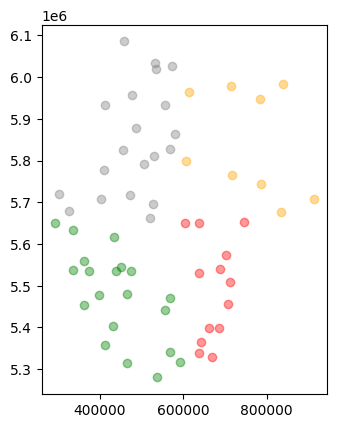

In [221]:
base=Germany_AirTopLeft.plot(facecolor='grey', alpha=0.4)
Germany_AirTopRight.plot(ax=base,facecolor='orange', alpha=0.4)
Germany_AirBottomLeft.plot(ax=base,facecolor='green', alpha=0.4)
Germany_AirBottomRight.plot(ax=base,facecolor='red', alpha=0.4)

Notice we have simple points in each subset:

In [222]:
Germany_AirBottomLeft

,name,kind,latitude_deg,longitude_deg,elevation_ft,region_name,municipality,geometry
7,Frankfurt-Hahn Airport,medium_airport,49.948700,7.263890,1649.0,Rhineland-Palatinate,Frankfurt am Main (Lautzenhausen),POINT (375448.986 5534371.602)
13,Friedrichshafen Airport,medium_airport,47.671299,9.511490,1367.0,Baden-Württemberg,Friedrichshafen,POINT (538396.545 5279894.231)
18,Memmingen Allgau Airport,medium_airport,47.988800,10.239500,2077.0,Bavaria,Memmingen,POINT (592480.399 5315798.712)
21,Karlsruhe Baden-Baden Airport,medium_airport,48.779400,8.080500,408.0,Baden-Württemberg,Rheinmünster,POINT (432449.311 5403340.922)
23,Saarbrücken Airport,medium_airport,49.214600,7.109510,1058.0,Saarland,Saarbrücken,POINT (362323.456 5453032.307)
25,Ramstein Air Base,medium_airport,49.436901,7.600280,776.0,Rhineland-Palatinate,Ramstein-Miesenbach,POINT (398520.954 5476967.602)
32,Mannheim-City Airport,medium_airport,49.473057,8.514167,308.0,Baden-Württemberg,Mannheim,POINT (464802.763 5480158.876)
33,Frankfurt-Egelsbach Airport,medium_airport,49.960000,8.643043,384.0,Hesse,Egelsbach,POINT (474396.745 5534244.396)
42,Lahr Airport,medium_airport,48.369301,7.827720,511.0,Baden-Württemberg,None,POINT (413179.828 5358011.709)
45,Donaueschingen-Villingen Airfield,medium_airport,47.973331,8.522222,2231.0,Baden-Württemberg,Donaueschingen,POINT (464341.587 5313446.524)


In this situation, you can NOT make a _convex hull_:

<Axes: >

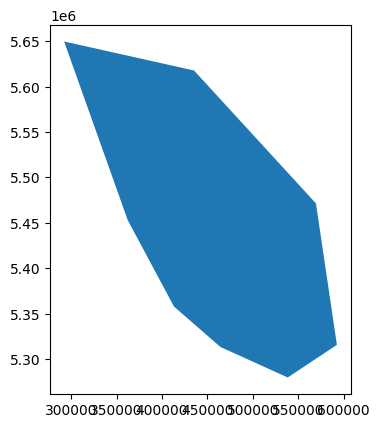

In [223]:
Germany_AirBottomLeft.dissolve().convex_hull.plot()

<Axes: >

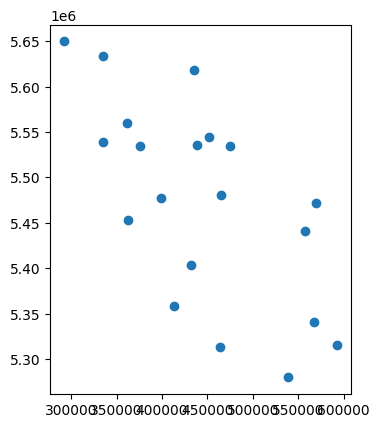

In [224]:
Germany_AirBottomLeft.convex_hull.plot()

You first need to **dissolve**, and then you create a hull, an envelope of  convex angles:

As we saw, the convex hull is a polygon:

In [225]:
Germany_AirBottomLeft.dissolve().convex_hull

,0
0,"POLYGON ((538396.545 5279894.231, 464341.587 5..."


What if we the polygons had not been previously combined?

<Axes: >

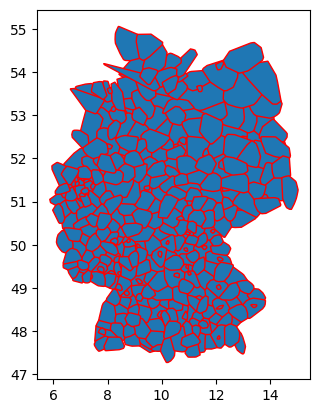

In [226]:
Germany_municipalities.cx[:centroidX,:centroidY].convex_hull.plot(edgecolor='red')

That is, you get a convex hull for each geometry.

We can also use _union_ before creating a convex hull:

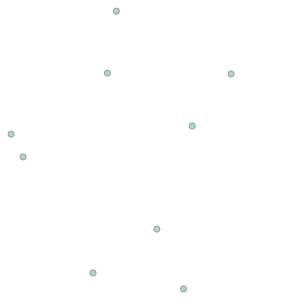

In [200]:
# just the union
large_airport=airports_25832[airports_25832.kind=='large_airport']
large_airport.union_all()

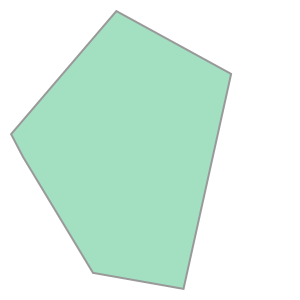

In [227]:
# hull of the union
large_airport.union_all().convex_hull

Let's turn the GS into a GDF:

In [228]:
LargeAirport_hull= gpd.GeoDataFrame(index=[0],
                                    crs=large_airport.crs,
                                    geometry=[large_airport.union_all().convex_hull])
LargeAirport_hull['name']='large airports hull' # optional

# then

LargeAirport_hull

,geometry,name
0,"POLYGON ((706396.099 5359376.354, 516335.256 5...",large airports hull


Let's use the GDF in plotting:

<Axes: >

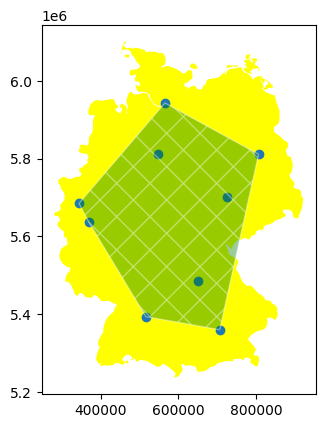

In [229]:
base=Germany_25832.plot(facecolor='yellow')
large_airport.plot(ax=base)
LargeAirport_hull.plot(ax=base,facecolor='green',
                       edgecolor='white',alpha=0.4,
                       hatch='X')

### Exercise 3

<div class="alert-success">

1. Select some points from your maps.
    
2. Create the convex hull for those points.
    
3. Turn the hull into a GDF.
    
4. Plot the hull on top of the country.
    
</div>

[TOC](#0)
_____________

<a class="anchor" id="5"></a>
# Spatial Overlay

We might need to create or find some geometries from the geometries we already have. Using a set theory approach, we will se the use of _intersection_, _union_, _difference_, and _symmetric difference_.

Let me create this GeoDFs:

In [241]:
Germany_union = Germany_municipalities.union_all()
Germany_centroid = Germany_union.centroid
x, y = Germany_centroid.x, Germany_centroid.y

In [242]:
# Definimo nuestros cuadrantes
# Norte
MunisN_germany=Germany_municipalities.cx[:,y:]
# Sur
MunisS_germany=Germany_municipalities.cx[:,:y]
# Oeste
MunisW_germany=Germany_municipalities.cx[:x,:]
# Este
MunisE_germany=Germany_municipalities.cx[x:,:]

Let me plot:

<Axes: >

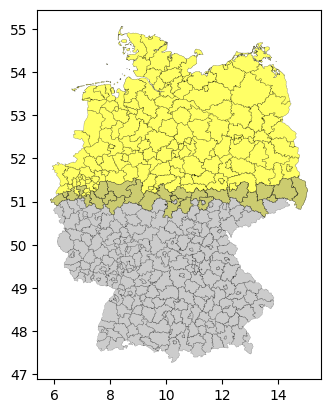

In [243]:
base=MunisN_germany.plot(facecolor='yellow', edgecolor='black',linewidth=0.2, alpha=0.6)
MunisS_germany.plot(facecolor='grey', edgecolor='black',linewidth=0.2,ax=base, alpha=0.4)

<Axes: >

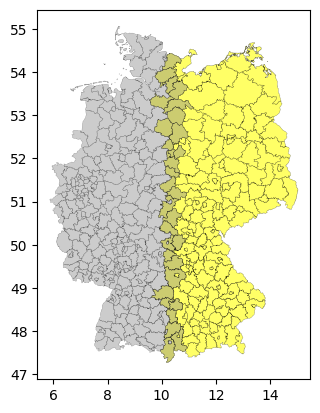

In [244]:
base=MunisE_germany.plot(facecolor='yellow', edgecolor='black',linewidth=0.2, alpha=0.6)
MunisW_germany.plot(facecolor='grey', edgecolor='black',linewidth=0.2,ax=base, alpha=0.4)

## Intersection

We keep what is common between GeoDFs:

<Axes: >

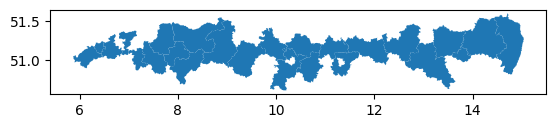

In [246]:
munisNS_Germany=MunisN_germany.overlay(MunisS_germany, how="intersection",keep_geom_type=True)
munisNS_Germany.plot()

<Axes: >

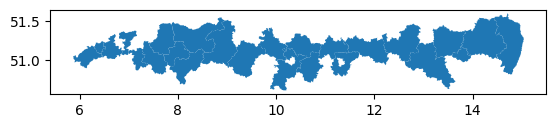

In [247]:
MunisN_germany.sjoin(MunisS_germany, how="inner", predicate='contains').plot()

<Axes: >

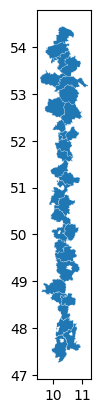

In [248]:
# keeping the overlay
munisWE_Germany=MunisW_germany.overlay(MunisE_germany, how="intersection",keep_geom_type=True)
munisWE_Germany.plot(edgecolor='white',linewidth=0.1)

## Union

Let me unite any polygons that touche each other. First, take a look at each one:

In [249]:
munisNS_Germany.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 27 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   GID_2_1      25 non-null     object  
 1   GID_0_1      25 non-null     object  
 2   COUNTRY_1    25 non-null     object  
 3   GID_1_1      25 non-null     object  
 4   NAME_1_1     25 non-null     object  
 5   NL_NAME_1_1  25 non-null     object  
 6   NAME_2_1     25 non-null     object  
 7   VARNAME_2_1  25 non-null     object  
 8   NL_NAME_2_1  25 non-null     object  
 9   TYPE_2_1     25 non-null     object  
 10  ENGTYPE_2_1  25 non-null     object  
 11  CC_2_1       25 non-null     object  
 12  HASC_2_1     25 non-null     object  
 13  GID_2_2      25 non-null     object  
 14  GID_0_2      25 non-null     object  
 15  COUNTRY_2    25 non-null     object  
 16  GID_1_2      25 non-null     object  
 17  NAME_1_2     25 non-null     object  
 18  NL_NAME_1_2  25 non-null

In [250]:
munisWE_Germany.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 31 entries, 0 to 30
Data columns (total 27 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   GID_2_1      31 non-null     object  
 1   GID_0_1      31 non-null     object  
 2   COUNTRY_1    31 non-null     object  
 3   GID_1_1      31 non-null     object  
 4   NAME_1_1     31 non-null     object  
 5   NL_NAME_1_1  31 non-null     object  
 6   NAME_2_1     31 non-null     object  
 7   VARNAME_2_1  31 non-null     object  
 8   NL_NAME_2_1  31 non-null     object  
 9   TYPE_2_1     31 non-null     object  
 10  ENGTYPE_2_1  31 non-null     object  
 11  CC_2_1       31 non-null     object  
 12  HASC_2_1     31 non-null     object  
 13  GID_2_2      31 non-null     object  
 14  GID_0_2      31 non-null     object  
 15  COUNTRY_2    31 non-null     object  
 16  GID_1_2      31 non-null     object  
 17  NAME_1_2     31 non-null     object  
 18  NL_NAME_1_2  31 non-null

In [251]:
munisWE_Germany.head()

,GID_2_1,GID_0_1,COUNTRY_1,GID_1_1,NAME_1_1,NL_NAME_1_1,NAME_2_1,VARNAME_2_1,NL_NAME_2_1,TYPE_2_1,...,NAME_1_2,NL_NAME_1_2,NAME_2_2,VARNAME_2_2,NL_NAME_2_2,TYPE_2_2,ENGTYPE_2_2,CC_2_2,HASC_2_2,geometry
0,DEU.1.16_1,DEU,Germany,DEU.1_1,Baden-Württemberg,NA,Heidenheim,NA,NA,Landkreis,...,Baden-Württemberg,NA,Heidenheim,NA,NA,Landkreis,District,08135,DE.BW.HH,"MULTIPOLYGON (((10.24109 48.50013, 10.23751 48..."
1,DEU.1.29_1,DEU,Germany,DEU.1_1,Baden-Württemberg,NA,Ostalbkreis,NA,NA,Landkreis,...,Baden-Württemberg,NA,Ostalbkreis,NA,NA,Landkreis,District,08136,DE.BW.OA,"MULTIPOLYGON (((9.76594 48.7283, 9.76606 48.72..."
2,DEU.2.6_1,DEU,Germany,DEU.2_1,Bayern,NA,Ansbach,NA,NA,Landkreis,...,Bayern,NA,Ansbach,NA,NA,Landkreis,District,09571,DE.BY.AN,"POLYGON ((10.66685 49.08319, 10.67054 49.08384..."
3,DEU.2.23_1,DEU,Germany,DEU.2_1,Bayern,NA,Dillingen an der Donau,NA,NA,Landkreis,...,Bayern,NA,Dillingen an der Donau,NA,NA,Landkreis,District,09773,DE.BY.DD,"POLYGON ((10.58965 48.49136, 10.59149 48.49077..."
4,DEU.2.38_1,DEU,Germany,DEU.2_1,Bayern,NA,Günzburg,NA,NA,Landkreis,...,Bayern,NA,Günzburg,NA,NA,Landkreis,District,09774,DE.BY.GN,"POLYGON ((10.37444 48.1677, 10.37407 48.16701,..."


Let me subset and show you:

In [252]:
# Nos quedamos con las columnas necesarias
keep=['COUNTRY_1','NAME_1_1','NAME_2_1','geometry']
munisNS_Germany=munisNS_Germany.loc[:,keep]
munisWE_Germany=munisWE_Germany.loc[:,keep]

In [253]:
# now
munisNS_Germany.overlay(munisWE_Germany,how="union",keep_geom_type=True).head()

,COUNTRY_1_1,NAME_1_1_1,NAME_2_1_1,COUNTRY_1_2,NAME_1_1_2,NAME_2_1_2,geometry
0,Germany,Thüringen,Unstrut-Hainich-Kreis,Germany,Thüringen,Unstrut-Hainich-Kreis,"POLYGON ((10.73913 51.11165, 10.73878 51.11166..."
1,Germany,Thüringen,Wartburgkreis,Germany,Thüringen,Wartburgkreis,"POLYGON ((10.05456 50.66891, 10.05403 50.67116..."
2,Germany,Hessen,Schwalm-Eder-Kreis,NaN,NaN,NaN,"POLYGON ((9.46179 50.80148, 9.46128 50.80041, ..."
3,Germany,Hessen,Waldeck-Frankenberg,NaN,NaN,NaN,"POLYGON ((8.58892 50.95042, 8.58675 50.95045, ..."
4,Germany,Hessen,Werra-Meißner-Kreis,NaN,NaN,NaN,"POLYGON ((10.18467 51.04903, 10.18523 51.04814..."


As you see, geometries are fine, but not attributes. It is strictly NOT appending the GeoDFs:

In [254]:
# appending
import pandas as pd

pd.concat([munisNS_Germany,munisWE_Germany],ignore_index=True).head()

,COUNTRY_1,NAME_1_1,NAME_2_1,geometry
0,Germany,Hessen,Schwalm-Eder-Kreis,"POLYGON ((9.46179 50.80148, 9.46128 50.80041, ..."
1,Germany,Hessen,Waldeck-Frankenberg,"POLYGON ((8.58892 50.95042, 8.58675 50.95045, ..."
2,Germany,Hessen,Werra-Meißner-Kreis,"POLYGON ((10.17107 51.04918, 10.17744 51.04881..."
3,Germany,Nordrhein-Westfalen,Heinsberg,"POLYGON ((6.15359 50.9137, 6.15291 50.91262, 6..."
4,Germany,Nordrhein-Westfalen,Hochsauerlandkreis,"POLYGON ((8.41938 51.40813, 8.41938 51.40863, ..."


This are different operations. UNION will combine any geometries that have overlaping portions in common.

<Axes: >

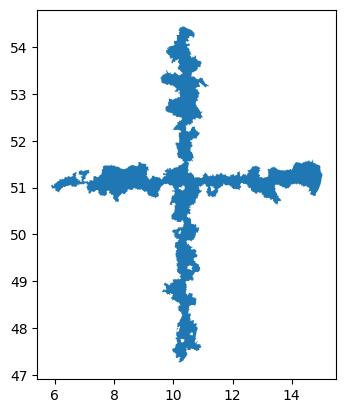

In [255]:
munisNS_Germany.dissolve().overlay(munisWE_Germany.dissolve(), how="union",keep_geom_type=True).dissolve().plot()

Let me create an object to save the previous result:

In [256]:
muniMidgermany=munisNS_Germany.dissolve().overlay(munisWE_Germany.dissolve(), how="union",keep_geom_type=True).dissolve()
muniMidgermany


,geometry,COUNTRY_1_1,NAME_1_1_1,NAME_2_1_1,COUNTRY_1_2,NAME_1_1_2,NAME_2_1_2
0,"MULTIPOLYGON (((10.12054 47.99708, 10.12077 47...",Germany,Hessen,Schwalm-Eder-Kreis,Germany,Baden-Württemberg,Heidenheim


In [257]:
# some cleaning

muniMidgermany['zone']='middles'
muniMidgermany=muniMidgermany.loc[:,['COUNTRY_1_1','zone','geometry']]
muniMidgermany

,COUNTRY_1_1,zone,geometry
0,Germany,middles,"MULTIPOLYGON (((10.12054 47.99708, 10.12077 47..."


## Difference

Here, you keep what belongs to the GeoDF to left that is not in the GeoDF to the right:

<Axes: >

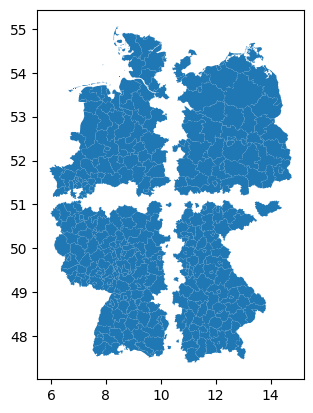

In [258]:
# with the municipalities
Germany_municipalities.overlay(muniMidgermany, how='difference').plot()

## Symmetric Difference

This is the opposite to *intersection*, you keep what is not in the intersection:

<Axes: >

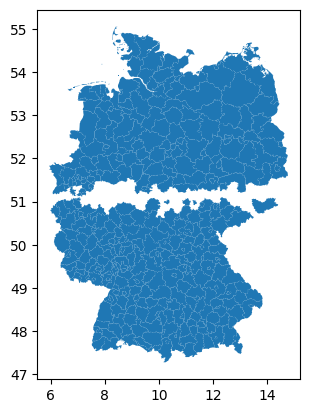

In [259]:
MunisN_germany.overlay(MunisS_germany, how="symmetric_difference",keep_geom_type=False).plot()

<Axes: >

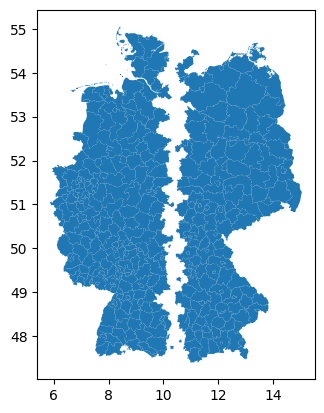

In [260]:
MunisW_germany.overlay(MunisE_germany, how="symmetric_difference",keep_geom_type=False).plot()

# Exercise 4

<div class="alert-success">

Apply two spatial overlays to your maps. If possible. If not, try the codes below.

        
</div>

[TOC](#0)
_____________

<a class="anchor" id="6"></a>

# Validity of Geometry

Geometries are created in a way that some issues may appear, especially in (multi) polygons.
Let's check if our recent maps on states and municipalities are valid:

In [261]:
# non valid
MunisS_germany[~MunisS_germany.is_valid]

,GID_2,GID_0,COUNTRY,GID_1,NAME_1,NL_NAME_1,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry


ValueError: aspect must be finite and positive 

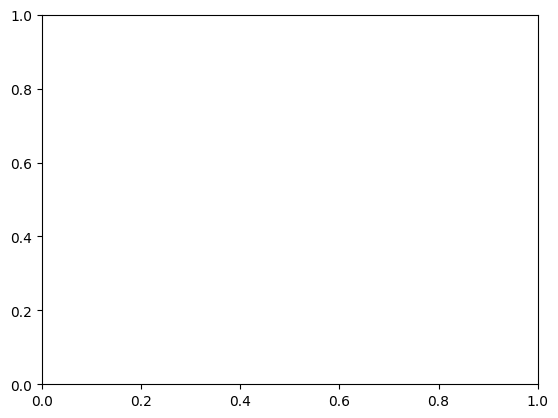

In [262]:
# see the invalid:
MunisS_germany[~MunisS_germany.is_valid].plot()

It is difficult to see what is wrong. Let's get some information:

In [263]:
# what is wrong?

from shapely.validation import explain_validity, make_valid

explain_validity(MunisS_germany[~MunisS_germany.is_valid].geometry)

,geometry


In [264]:
# varieties?
MunisS_germany['validity']=[x.split('[')[0] for x in MunisS_germany.geometry.apply(lambda x: explain_validity(x))]
MunisS_germany['validity'].value_counts()

,count
validity,
Valid Geometry,257


In [ ]:
# solving the issue:
MunisS_brazil.drop(columns=['validity'],inplace=True)

MunisS_brazil_valid=MunisS_brazil.copy()

MunisS_brazil_valid['geometry'] = [make_valid(row)  if not row.is_valid else row for row in MunisS_brazil_valid['geometry'] ]
#any invalid?
MunisS_brazil_valid[~MunisS_brazil_valid.is_valid]

The _solution_ we got may help for some advanced techniques, but may also give us some extra trouble. Notice that once geopandas solved the problem, you  have created **collections**:

In [ ]:
pd.Series([type(x) for x in MunisS_brazil_valid.geometry]).value_counts()

Let's do the same for the other GDFs:

In [ ]:
# solving the issue:

MunisN_brazil_valid=MunisN_brazil.copy()
MunisE_brazil_valid=MunisE_brazil.copy()
MunisW_brazil_valid=MunisW_brazil.copy()

MunisN_brazil_valid['geometry'] = [make_valid(row)  if not row.is_valid else row for row in MunisN_brazil_valid['geometry'] ]
MunisE_brazil_valid['geometry'] = [make_valid(row)  if not row.is_valid else row for row in MunisE_brazil_valid['geometry'] ]
MunisW_brazil_valid['geometry'] = [make_valid(row)  if not row.is_valid else row for row in MunisW_brazil_valid['geometry'] ]


In [ ]:
MunisN_brazil_valid.overlay(MunisS_brazil_valid, how="symmetric_difference",keep_geom_type=True).plot()

In [ ]:
MunisN_brazil_cleaned = MunisN_brazil_valid.copy()
MunisS_brazil_cleaned = MunisS_brazil_valid.copy()
MunisE_brazil_cleaned = MunisE_brazil_valid.copy()
MunisW_brazil_cleaned = MunisW_brazil_valid.copy()

# Apply buffer(0) to potentially fix remaining issues
MunisN_brazil_cleaned['geometry'] = MunisN_brazil_cleaned.geometry.buffer(0)
MunisS_brazil_cleaned['geometry'] = MunisS_brazil_cleaned.geometry.buffer(0)
MunisE_brazil_cleaned['geometry'] = MunisE_brazil_cleaned.geometry.buffer(0)
MunisW_brazil_cleaned['geometry'] = MunisW_brazil_cleaned.geometry.buffer(0)

In [ ]:
# Try the overlay with the cleaned dataframes
MunisN_brazil_cleaned.overlay(MunisS_brazil_cleaned, how="symmetric_difference", keep_geom_type=True).plot()

In [ ]:
MunisE_brazil_cleaned.overlay(MunisW_brazil_cleaned, how="symmetric_difference", keep_geom_type=True).plot()